<b>Szpitale Massachusetts</b> 

<b>Opis projektu</b><br> 
Tematem projektu są szpitale w stanie Massachusetts. Analizuję odległość poszególnych części stanu od szpitali, sprawdzając tym samych, do którego szpitala w razie nagłej potrzeby powinni się udać mieszkańcy danych gmin, tak by był on najbliższy. Gminami będę określała w projekcie miasta "towns" (w stanie Massachusetts jesy ich 312) i miasta "cities" (jest ich 39). Drugą częścią analizy jest znalezienie szpitala, do którego przyjedzie najwięcej osób, ponieważ populacja gmin, dla których jest on najbliższy jest największa, oraz szpitala, dla którego ta populacja jest najmniejsza. Taka analiza może być pomocna przy decyzji, który szpital należałoby rozbudować lub przeznaczyć na niego większe środki. 

<b>Opis danych</b> <br> Dane do projektu pobieram z plików shp. W pliku <i>TOWNSSURVEY_POLYM.shp</i> znajdują sie dane dotyczące gmin w stanie Massachusetts. Dla każdej gminy jest m.in. nazwa, id, geometria oraz populacja w różnych latach. Do mojej analizy użyłam danych o populacji z 2010 roku. Gminy są poligonami lub multipoligonami. Plik <i>HOSPITALS_PT.shp</i> zawiera dane dotyczące szpitali intensywnej terapii na terenie stanu Massachusetts. Można tam znaleźć informacje o nazwie szpitala, jego id, adresie oraz geometrii. Szpitale są reprezentowane przez punkty.

<b>Massachusetts</b><br> 
Wczytuję dane z pliku <i>TOWNSSURVEY_POLYM.shp</i> i wyświetlam mapę stanu Massachusetts z zaznaczonymi na niej gminami.

<AxesSubplot: >

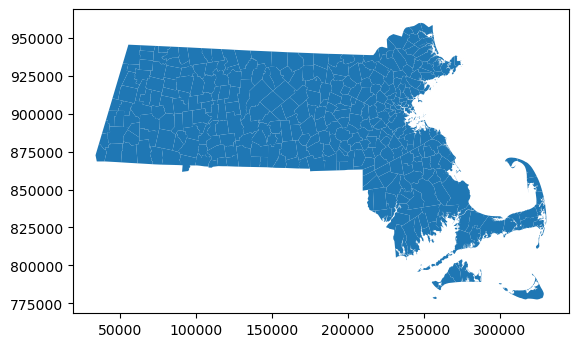

In [1]:
import geopandas as gpd
from pyproj import CRS
import matplotlib.pyplot as ply

massachusetts = gpd.read_file('TOWNSSURVEY_POLYM.shp')
massachusetts.plot()

<b>Szpitale intensywnej terapii</b> <br>
Wczytuję dane z pliku <i>HOSPITALS_PT.shp</i> i wyświetlam położenie szpitali.

<AxesSubplot: >

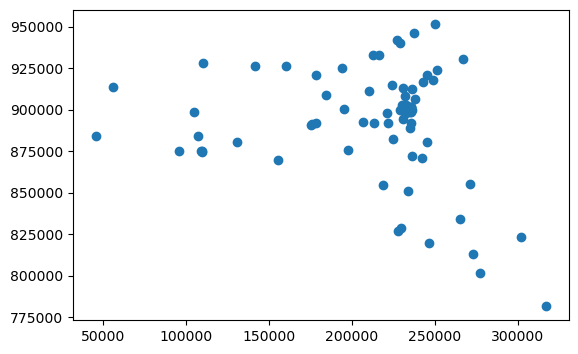

In [2]:
hospitals = gpd.read_file('HOSPITALS_PT.shp')
hospitals.plot()

<b>Ustawienie CRS</b> <br>
Przeprowadzam projekcję danych  zmiennej <i>massachusetts</i> na EPSG:3857. Następnie sprawdzam czy dane w zmiennej <i>hospitals</i>
mają identyczne wartości CRS, jeśli nie to je ujednolicam.

In [3]:
massachusetts = massachusetts.to_crs(epsg = 3857)
if not hospitals.crs == massachusetts.crs:
    hospitals = hospitals.to_crs(massachusetts.crs)

<b>Stan Massachusetts z zaznaczonymi szpitalami</b> <br>
Na wspólnym wykresie o rozmiarze 15x10 nanoszę dane ze zmiennych massachusetts i hospitals. 
W kolumnie <i>FOURCOLOR</i> znajdują się liczyby od 1 do 4 dobrane tak, by żadne dawie gminy leżące obok siebie nie miały identycznych liczb. Na podsawie tej kolumny usawiam kolory dla gmin. Ustawiam także przezroczystość wykresu na 0.8 oraz kolor punktów reprezentujących szpitale na czarny.

<AxesSubplot: >

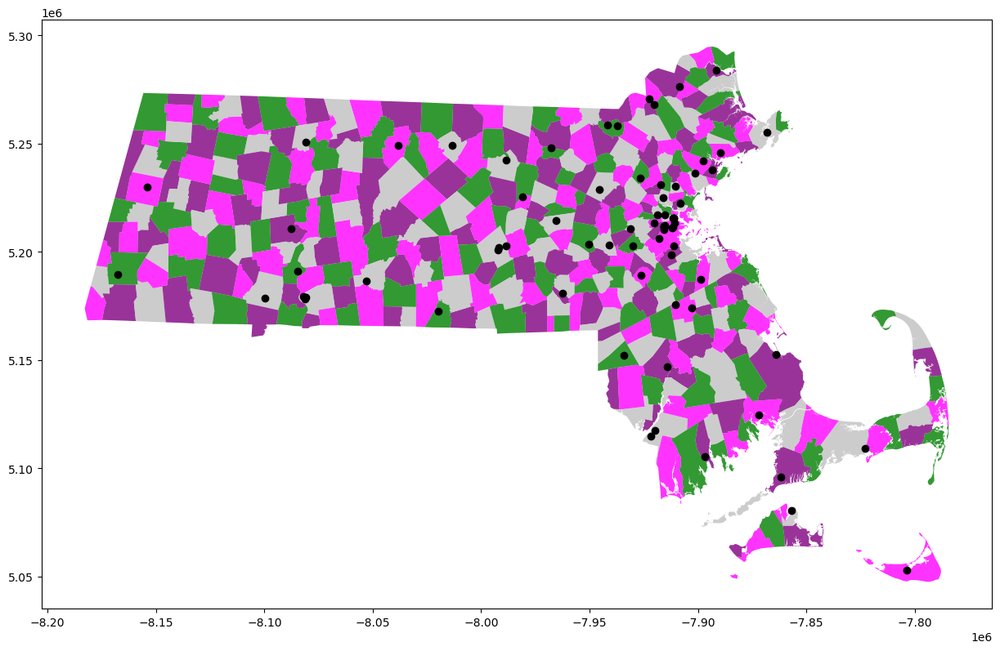

In [4]:
fig, ax = ply.subplots(figsize = (15, 10))
colors = {1:'fuchsia', 2:'purple', 3:'silver', 4:'green'}
massachusetts.plot(ax=ax, color =  massachusetts['FOURCOLOR'].map(colors), alpha = 0.8)
hospitals.plot(ax=ax, color ='black')

<b>Centroidy gmin</b> <br>
Abym mogła dla każdej gmini znaleźć najbliższy szpital muszę wyznaczyć centroidy każdego z poligonów lub multipoligonów reprezentujących gminę. 
Dodaję kolumnę <i>centroid</i> do zmiennej <i>massachusetts</i> i zapisuję w niej wyznaczone centroidy dla każdej gminy.
Następnie wyświetlam wykres kolumny <i>centroid</i>.

<AxesSubplot: >

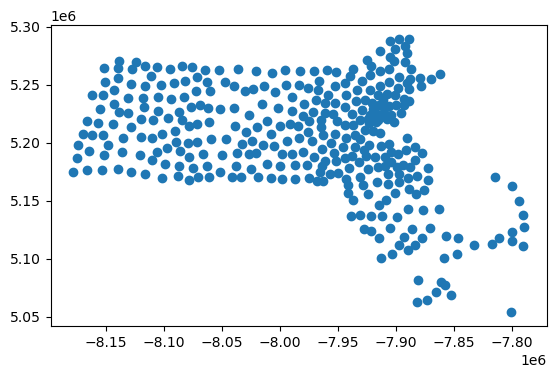

In [5]:
from shapely.geometry.base import BaseGeometry
massachusetts['centroid'] = massachusetts['geometry'].centroid
massachusetts['centroid'].plot()

<b>Najbliższy szpital dla gminy</b> <br>
Aby znaleźć najbliższy szpital intensywnej terapii dla gminy muszę policzyć odległość centroidy gminy od każdego ze szpitali, a następnie wybrać ten szpital, dla którego ta odległość jest najmniejsza. Funkcja <i>distance</i> zwraca minimalną odległość między dwoma punktami, natomiast funkcja <i>closest_point</i> zwraca id najbliższego punktu z listy. 
Wywołuję metodę <i>closest_point</i> dla każdej gminy i listy szpitali, a wyniki zapisuję w zmiennej <i>massachusetts</i> w nowo utworzonej kolumnie <i>hospital_point</i>

In [6]:
import numpy as np
from scipy.spatial import distance

def distance(pt_1, pt_2):
    return pt_1.distance(pt_2)

def closest_point(point, geoDataFrame):
    pt_id = geoDataFrame['IDNUMBER'][0]
    dist = distance(point, geoDataFrame['geometry'][0])
    for index, row in geoDataFrame.iterrows():
        n = row['geometry']
        if distance(point, n) <= dist:
            dist = distance(point, n)
            pt_id =  row['IDNUMBER']
    return pt_id

massachusetts['hospital_point'] =  [closest_point(i, hospitals) for i in massachusetts['centroid']]

<b>Najbliższy szpital dla gminy - wykres</b> <br>
Tak jak wcześniej naniosę na wspólnym wykresie o rozmiarze 15x10 dane ze zmiennych <i>massachusetts</i> i <i>hospitals</i>. Zmienię jednak sposób wyświetlania zmiennej <i>massachusetts</i>. Zamiast utworzonej wcześniej przeze mnie mapy kolorów użyję już zdefiniowanej mapy <i>cubehelix</i>. Natomiast kolor gminy będzie zależny od jej najbliższego szpitala, a nie od columny <i>FOURCOLOR</i>. Dzięki temu gminy należące do tego samego szpitala, będą na wykresie tego samego koloru.

<AxesSubplot: >

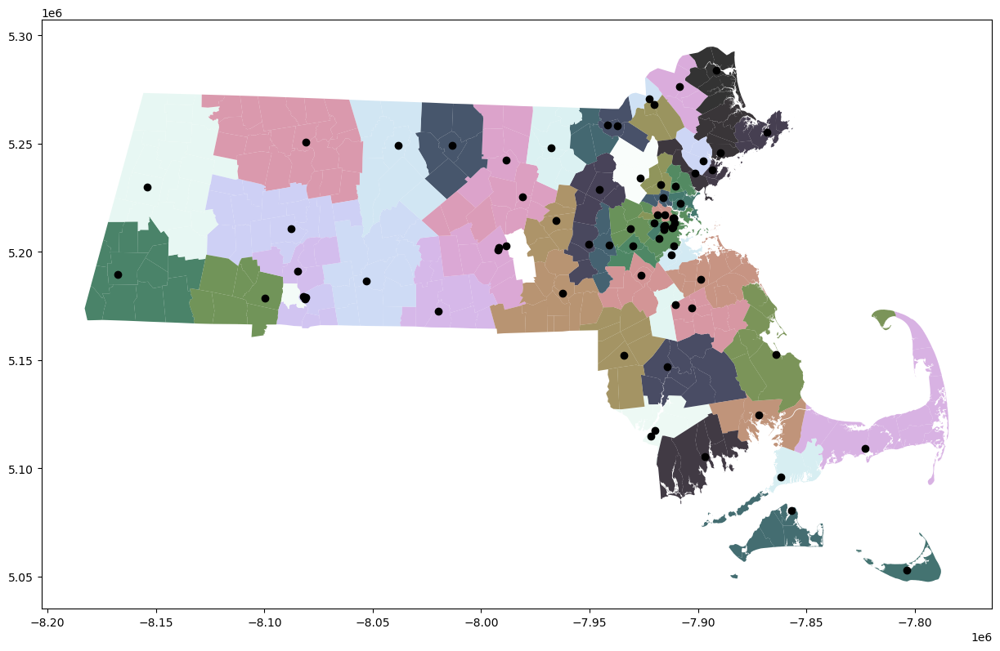

In [7]:
fig, ax = ply.subplots(figsize = (15, 10))
massachusetts.plot(ax=ax, column= 'hospital_point', cmap= 'cubehelix', alpha = 0.8)
hospitals.plot(ax=ax, color ='black')

<b>Populacja dla szpitala</b><br> 
Założyłam, że każda gmina, dla której dany szpital jest najbliższy przynależy do tego szpitala. Aby policzyć ilość osób teoretycznie leczących się w danym szpitalu muszę zsumować populację wszystkich gmin należących do szpitala. Aby to zrobic tworzę zmienną <i>grouped_by_hospital</i> i zapisuję do niej zsumowane dane populacji pogrupowane po id najbliższego szpitala. Analizę przeprowadzam dla danych z 2010 roku.

In [8]:
grouped_by_hospital = massachusetts.groupby(['hospital_point'])['POP2010'].agg('sum')

<b>Złączone dane o szpitalu i populacji </b> <br> 
Dane o każdym szpitalu oraz jego geometria znajdują się w zmiennej <i>hospitals</i>, a dane o populacji dla szpitala w zmiennej 
<i>grouped_by_hospital</i>. Aby dla każdego szpitala mieć dane o nim, jego geometrię i wielkość populacji, tworzę nową zmienną <i>hostital_pop2010</i>, do której wpisuję złączone dane ze zmiennych <i>grouped_by_hospital</i> i <i>hospitals</i>. Złączenia dokonuję po id szpitala, czyli  po kolumnie <i>hospital_point</i> ze zmiennej <i>grouped_by_hospital</i> oraz po kolumnie <i>IDNUMBER</i> ze zmiennej <i>hospitals</i>. Jest to złączenie lewostronne, ponieważ w dalszej analize nie będę brała pod uwagę szpitali,do których nie ma przypisanej żadnej gminy. Następnie upewniam się, że zmienna <i>hostital_pop2010</i> jest obiektem typu <i>GeoDataFrame</i>, oraz że CRS jest ustawiony na <i>EPSG:3857</i>. Na koniec sortuję dane po wielkości populacji rosnąco.

In [9]:
import pandas as pd
hostital_pop2010 = pd.merge(grouped_by_hospital, hospitals, how='left',left_on=['hospital_point'],right_on=['IDNUMBER'])
hostital_pop2010 = gpd.GeoDataFrame(hostital_pop2010,crs="EPSG:3857")
hostital_pop2010 = hostital_pop2010.sort_values(['POP2010'])

<b>Gminy, szpitale i populacja - wykres</b> <br>
Na wspólnym wykresie o rozmiarze 15x10 naniosę dane ze zmiennych <i>massachusetts</i> i <i>hostital_pop2010</i>. 
Tak jak wcześniej, gminy mają kolor zależny od szpitala, do którego mają najbliżej. 
Kolor punktów reprezentujących szpitale jest zależny od wielkości populacji na obszaże przynależącym do danego szpitala. 
Im ciemniejszy punkt tym populacja jest większa, co przedstawia legenda obok wykresu. Zapisuję mapę do pliku png.

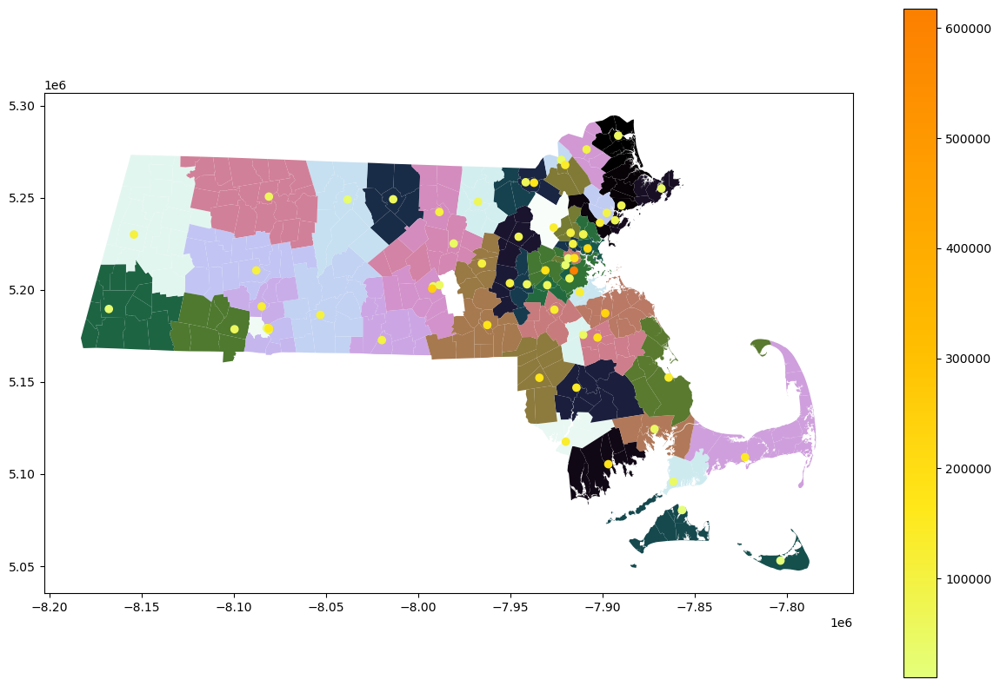

In [10]:
fig, ax = ply.subplots(figsize = (15, 10))
massachusetts.plot(ax=ax, column= 'hospital_point', cmap= 'cubehelix')
hostital_pop2010.plot(ax=ax, column = hostital_pop2010['POP2010'],  cmap= 'Wistia', legend = True) 
ply.savefig('static_map.png')

<b>Gminy, szpitale i populacja - wykres na mapie bazowej</b> <br>
Do powyższego wykresu dodaję mapę bazową.

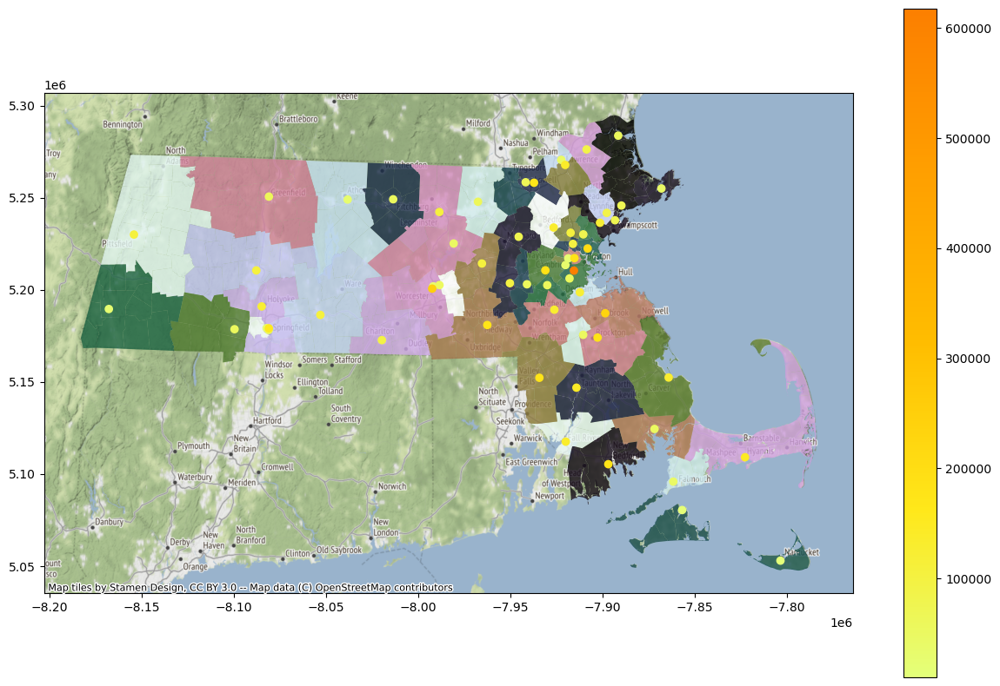

In [11]:
import contextily as ctx
fig, ax = ply.subplots(figsize = (15, 10))
massachusetts.plot(ax=ax, column= 'hospital_point', cmap= 'cubehelix', alpha = 0.8)
hostital_pop2010.plot(ax=ax, column = hostital_pop2010['POP2010'],  cmap= 'Wistia', legend = True) 
ctx.add_basemap(ax)

<b>Największa, średnia i najmniejsza populacja dla szpitala</b> <br>
Sprawdzam i wypisuję szpital z największą i najmniejszą populacją oraz średnią populację dla szpitali w Massachusetts.

In [12]:
from statistics import mean

bigest_hospital_pop = max(hostital_pop2010["POP2010"])
for index, row in hostital_pop2010.iterrows():
    if row["POP2010"] == bigest_hospital_pop:
        bigest_hospital = row["NAME"]
        bigest_hospital_town = row["GEOG_TOWN"]
print(f"Szpital z największą populacją to: {bigest_hospital} w {bigest_hospital_town}, a populacja dla niego wynosi: {bigest_hospital_pop}")

mean_pop = mean(hostital_pop2010["POP2010"])
print(f"Średnia wielkość populacji dla szpitala: {mean_pop}")

smallest_hospital_pop = min(hostital_pop2010["POP2010"])
for index, row in hostital_pop2010.iterrows():
    if row["POP2010"] == smallest_hospital_pop:
        smallest_hospital = row["NAME"]
        smallest_hospital_town = row["GEOG_TOWN"]
print(f"Szpital z najmniejszą populacją to: {smallest_hospital} w {smallest_hospital_town}, a populacja dla niego wynosi: {smallest_hospital_pop}")

Szpital z największą populacją to: New England Baptist Hospital w BOSTON, a populacja dla niego wynosi: 617594
Średnia wielkość populacji dla szpitala: 105606.91935483871
Szpital z najmniejszą populacją to: Nantucket Cottage Hospital w NANTUCKET, a populacja dla niego wynosi: 10172


<b>Długość i szerokość geograficzna szpitali</b> <br>
Przeprowadzam projekcję danych na <i>EPSG:4326</i>. Na podstawie współrzędnych punktów reprentujących szpitale wyznaczam ich długość i szerokość geograficzną i zapisuję je w 
nowych kolumnach zmiennej <i>hospitals</i>. 

In [13]:
hospitals = hospitals.to_crs(epsg = 4326)
hospitals['lon'] = hospitals['geometry'].x
hospitals['lat'] = hospitals['geometry'].y

<b>GeoJson</b> <br>
Tworzę nową zmienną <i>municipalities</i>, do której wpisuję dane ze zmiennej <i>massachusetts</i>, 
ale ograniczone do czterech kolumn. Dane ze zmiennej <i>municipalities</i> zapisuję w formacie typu GeoJson w zmiennej o 
nazwie <i>geojson</i>.

In [14]:
import folium
municipalities = massachusetts.loc[ : , ["TOWN", "TOWN_ID", "FOURCOLOR", "geometry"]]
geojson = folium.features.GeoJson(municipalities, name = "Municipalities")

<b>Interaktywna mapa</b><br>
Tworzę interaktywną mapę na podstawie współrzędnych (42.21, -71.03), czli współrzędnych Bostonu. 
Na interaktywną mapę o stylu kafelek cartodbpositron nanoszę gminy ze zmiennej <i>geojson</i> oraz zgrupowane znaczniki na podstawie lokalizacji punktów szpitali. Szpitale będą przedstawione w postaci czerwonych pinezek z białym krzyżem. Po naciśnięci na pinezkę pojawi sie nazwa szpitala. Na koniec dodaję kontrolę warstw, zapisuję interaktywną mapę do pliku html oraz wyświetlam mapę.

In [15]:
import folium
from folium.plugins import MarkerCluster

m = folium.Map(location = [42.21, -71.03], tiles = 'cartodbpositron')
geojson.add_to(m)
marker_cluster=MarkerCluster(name="Hospitals").add_to(m)
for index, row in hospitals.iterrows():
    folium.Marker(
        location=[row['lat'], row['lon']], 
        popup = row['NAME'], 
        icon = folium.Icon(color='red', icon = 'glyphicon-plus')
                  ).add_to(marker_cluster)
folium.LayerControl().add_to(m)
m.save('interactive_map.html')
m